In [2]:
import librosa
import io    
audio_data = 'France.wav'                                                    
x,sr = librosa.load(audio_data)  

In [3]:
print("Sample rate  :", sr)
print("Signal Length:", len(x))
print("Duration     :", len(x)/sr, "seconds")

Sample rate  : 22050
Signal Length: 1368000
Duration     : 62.04081632653061 seconds


In [4]:
librosa.get_duration(x)

62.04081632653061

**Playing audio file in a Jupyter Notebook using IPython.display.Audio**

In [5]:
import IPython.display
IPython.display.Audio(audio_data) 

**Visualizations**

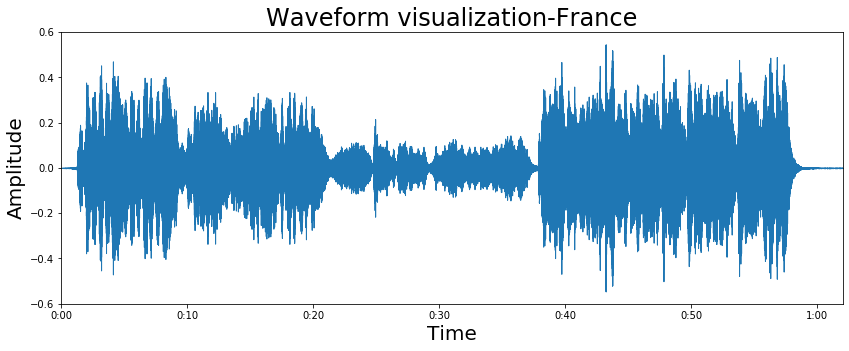

In [6]:
#######  Waveform visualization   ################# 
%matplotlib inline
import matplotlib.pyplot as plt                  
import librosa.display

plt.figure(figsize=(14, 5))
plt.title("Waveform visualization-France", fontsize=24)
plt.xlabel("Time", fontsize=20)
plt.ylabel("Amplitude", fontsize=20)
#plt.figure(figsize=(14, 5))                      #  Waveform visualization of th
librosa.display.waveplot(x, sr=sr,max_points=63)    

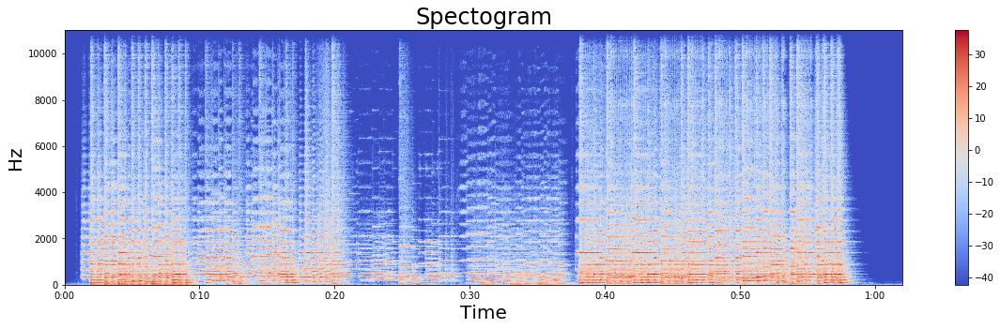

In [7]:
#######  Spectrogram   ################# 
X = librosa.stft(x)   # x:numpy array,.stft() converts data into short term Fourier transfor so that we can know amplitude of given frequency at given time
Xdb = librosa.amplitude_to_db(abs(X))            # converting into energy levels(dB)

plt.figure(figsize=(20, 5))
plt.title("Spectogram", fontsize=24)
plt.xlabel("Time", fontsize=20)
plt.ylabel("Freqeuncy (Hz)", fontsize=20)# spectrum of frequencies of a signal as it varies with time to see how energy levels (dB) vary over time.
librosa.display.specshow(Xdb, sr=sr, x_axis='time', y_axis='hz') # .specshow is used to display a spectrogram.
plt.colorbar() 

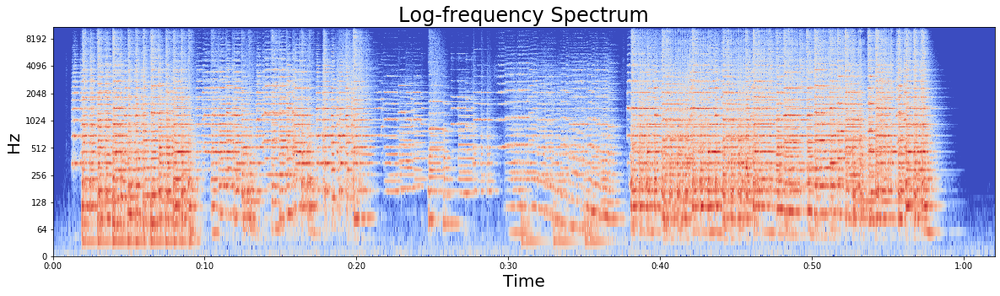

In [8]:
#######  Log-frequency spectrum   ################# 
plt.figure(figsize=(20, 5))
plt.title("Log-frequency Spectrum", fontsize=24)
plt.xlabel("Time", fontsize=20)
plt.ylabel("Log-freqeuncy", fontsize=20)
librosa.display.specshow(Xdb, sr=sr, x_axis='time', y_axis='log')  
# obtaining features from spectrogram by converting linear frequency axis into log axis
#  when we see that all action is taking place at the bottom of the spectrum, we can convert the frequency axis 
# to a logarithmic one.

***Beat locations & global Tempo*

In [9]:
tempo, beat_times = librosa.beat.beat_track(x, sr=sr, start_bpm=60, units='time')
print(tempo)
print(beat_times)

60.09265988372093
[ 0.27863946  1.27709751  1.9969161   2.99537415  4.01705215  5.03873016
  6.5015873   7.50004535  8.4985034   9.54340136 10.4954195  11.49387755
 12.4923356  13.49079365 14.4892517  15.4644898  16.43972789 17.43818594
 18.43664399 19.38866213 20.50321995 21.64099773 22.70911565 23.80045351
 24.82213152 25.82058957 26.79582766 27.77106576 28.67664399 29.698322
 30.65034014 31.57913832 32.50793651 33.43673469 34.34231293 35.29433107
 36.29278912 37.2215873  38.17360544 39.19528345 40.1937415  41.2154195
 42.1906576  43.2123356  44.21079365 45.2092517  46.20770975 47.22938776
 48.2278458  49.24952381 50.24798186 51.24643991 52.24489796 53.22013605
 54.26503401 55.26349206 56.26195011]


(-1, 1)

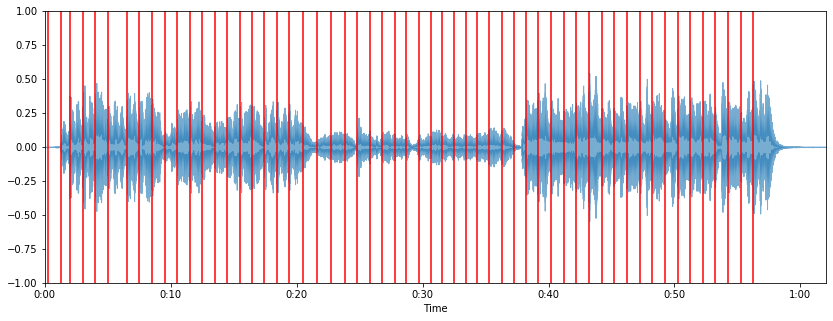

In [10]:
# Plot the beat locations over the waveform:
plt.figure(figsize=(14, 5))
librosa.display.waveplot(x, alpha=0.6)
plt.vlines(beat_times, -1, 1, color='r')
plt.ylim(-1, 1)

Text(0, 0.5, 'Count')

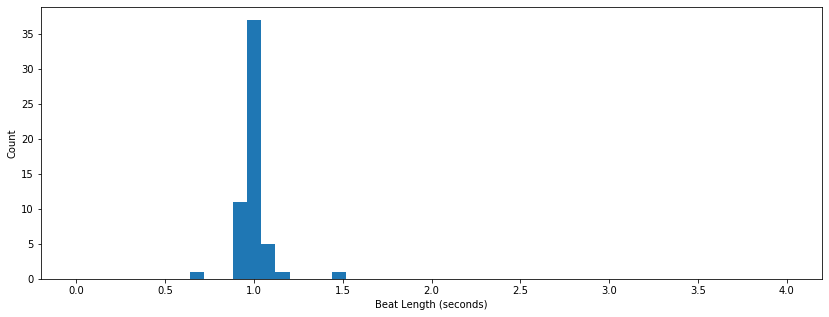

In [11]:
# Plot a histogram of the intervals between adjacent beats:
import numpy
beat_times_diff = numpy.diff(beat_times)
plt.figure(figsize=(14, 5))
plt.hist(beat_times_diff, bins=50, range=(0,4))
plt.xlabel('Beat Length (seconds)')
plt.ylabel('Count')

In [12]:
#Visually, it's difficult to tell how correct the estimated beats are. Let's listen to a click track:
import IPython.display as ipd
clicks = librosa.clicks(beat_times, sr=sr, length=len(x))
ipd.Audio(x + clicks, rate=sr)

In [13]:
#Estimate the tempo:
tempo = librosa.beat.tempo(x, sr=sr)
print(tempo)

[117.45383523]


In [14]:
#Visualize the tempo estimate on top of the input signal:
T = len(x)/float(sr)
seconds_per_beat = 60.0/tempo[0]
beat_times = numpy.arange(0, T, seconds_per_beat)

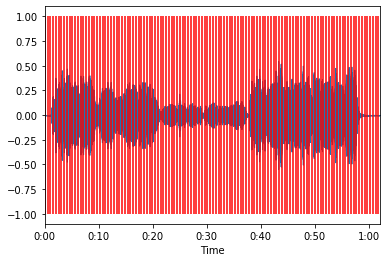

In [15]:
librosa.display.waveplot(x)
plt.vlines(beat_times, -1, 1, color='r')

In [16]:
#Listen to the input signal with a click track using the tempo estimate:
clicks = librosa.clicks(beat_times, sr, length=len(x))
ipd.Audio(x + clicks, rate=sr)

**Short-time energy**
Short term energy is used in different audio classification problems. In speech signals, it
provides a basis for distinguishing voiced speech segments from unvoiced ones. In the
case of a very high quality speech, the short term energy features are used to distinguish
speech from silence. 

In [17]:
hop_length = 256
frame_length = 512

In [18]:
energy = numpy.array([
    sum(abs(x[i:i+frame_length]**2))
    for i in range(0, len(x), hop_length)
])

In [19]:
energy.shape

(5344,)

In [20]:
rmse = librosa.feature.rms(x, frame_length=frame_length, hop_length=hop_length, center=True)

In [21]:
rmse.shape

(1, 5344)

In [22]:
rmse = rmse[0]

In [23]:
frames = range(len(energy))
t = librosa.frames_to_time(frames, sr=sr, hop_length=hop_length)

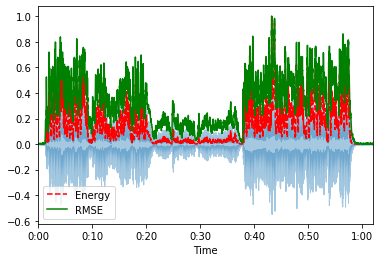

In [24]:
librosa.display.waveplot(x, sr=sr, alpha=0.4)
plt.plot(t, energy/energy.max(), 'r--')             # normalized for visualization
plt.plot(t[:len(rmse)], rmse/rmse.max(), color='g') # normalized for visualization
plt.legend(('Energy', 'RMSE'))